# **Best city to live**

# Exploratory Data Analysis (EDA)

Following preprocessing, an Exploratory Data Analysis (EDA) will be conducted to uncover patterns and insights within the data. EDA techniques will include:
- Descriptive statistics to summarize the data.
- Visualization tools like histograms, scatter plots, and box plots to reveal relationships and distributions.
- Correlation analysis to identify potential connections between different indicators.

## Index

1. [Libraries.](#Libraries)
2. [Reading the preprocessed datasets.](#Reading-the-preprocessed-datasets)
3. [Exploratory Data Analysis (EDA)](#exploratory-data-analysis-eda)
4. [K-Nearest-Neighbours (KNN)](#k-nearest-neighbours-knn)

## Datasets

- `city_df` dataset:
  - **City**: The name of the city.
  - **Country**: The country where the city is located.
  - **Continent**: The continent where the city is located.
  - **Housing**: Rating about afforability of houses in the city.
  - **Cost of Living**: The expense of living in the city.
  - **Startups**: The presence or number of startup companies in the city.
  - **Venture Capital**: The availability of venture capital funding for startups and businesses in the city.
  - **Travel Connectivity**: The ease of travel to and from the city, including transportation infrastructure and connectivity.
  - **Commute**: The average time and ease of commuting within the city.
  - **Business Freedom**: The level of freedom to conduct business activities in the city.
  - **Safety**: The safety and security level in the city.
  - **Healthcare**: The quality and availability of healthcare services in the city.
  - **Education**: The quality and availability of educational institutions and services in the city.
  - **Environmental Quality**: The quality of the environment in the city, including pollution levels and green spaces.
  - **Economy**: The economic strength and stability of the city, including job opportunities and economic growth.
  - **Taxation**: The tax rates and tax burden on individuals and businesses in the city.
  - **Internet Access**: The availability, speed, and quality of internet access in the city.
  - **Leisure & Culture**: The availability and quality of leisure and cultural activities in the city.
  - **Tolerance**: The level of tolerance and acceptance of diversity in the city.
  - **Outdoors**: The availability and quality of outdoor activities and natural environments in and around the city.
  - **AQI Value**: The Air Quality Index value, indicating the level of air pollution in the city.
  - **AQI Category**: The category or classification of the air quality based on the AQI value, such as Good, Moderate, Unhealthy, etc.
  - **lat**: The latitude coordinate of the city.
  - **lng**: The longitude coordinate of the city.

  *They are expressed as a range from 0.0 to 10.0 with the larger numbers indicating higher desirability to live.*


- `countries_df` dataset:
  - **Country**: The country being analyzed.
  - **Continent**: The continent where the country is located.
  - **year**: The year of the data being analyzed.
  - **Life Ladder**: A measure of subjective well-being, reflecting individuals' overall satisfaction with life.
  - **Log GDP per capita**: The logarithm of the country's Gross Domestic Product per capita, reflecting the economic output per person.
  - **Social support**: The level of social support available to individuals in the country, indicating the quality of social networks and relationships.
  - **Healthy life expectancy at birth**: The average number of years a newborn is expected to live in good health.
  - **Freedom to make life choices**: The extent to which individuals feel they have the freedom to make their own life decisions.
  - **Generosity**: The level of generosity in the country, often measured by the frequency of charitable donations and volunteer work.
  - **Perceptions of corruption**: The level of perceived corruption in the country, indicating the extent to which individuals believe corruption is present in their government and public institutions.

  *They are expressed as a range from 0.0 to 10.0 with the larger numbers indicating higher desirability to live.*


- `city_world_AQI`:
  - **AQI**: Air Quality Index


All the columns regarding the quality of life is expressed as a range from 0.0 to 10.0 with the larger numbers indicating higher desirability to live.

## Libraries:

In [106]:
import numpy as np
import pandas as pd
import seaborn as sns
sns.set()
import matplotlib.pyplot as plt
import requests
import os
import json
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)


import folium
from folium.plugins import FastMarkerCluster
import geopandas as gpd
from branca.colormap import LinearColormap
from folium.plugins import HeatMap


import plotly.graph_objs as go
import plotly_express as px
import chart_studio.plotly as py
from plotly.offline import iplot, init_notebook_mode
import cufflinks
cufflinks.go_offline(connected=True)
init_notebook_mode(connected=True)


from scipy.stats import shapiro
from scipy.stats import normaltest
from scipy.stats import mannwhitneyu
from scipy.stats import skew
from pycaret.regression import *
from scipy.stats import spearmanr
from scipy import stats
import mpld3
import logging
logging.basicConfig(filename='logs.log', level=logging.INFO)

from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors

## Reading the preprocessed datasets:

In [2]:
city_df = pd.read_csv("../clean_data/city_df.csv", encoding='latin-1')
countries_df = pd.read_csv("../clean_data/countries_df.csv", encoding='latin-1')
city_world_AQI = pd.read_csv("../clean_data/city_world_AQI.csv", encoding='latin-1')

In [3]:
print('city_df shape:', city_df.shape)
print('countries_df shape:', countries_df.shape)
print('city_world_AQI.csv shape:', city_world_AQI.shape)

city_df shape: (265, 24)
countries_df shape: (2240, 11)
city_world_AQI.csv shape: (14229, 6)


In [4]:
# Code to show all columns of the datasets
pd.set_option('display.max_columns', None)

# Code to show all rows of the datasets
pd.set_option('display.max_rows', None)

In [6]:
city_df.head(5)

,City,Country,Continent,Housing,Cost of Living,Startups,Venture Capital,Travel Connectivity,Commute,Business Freedom,Safety,Healthcare,Education,Environmental Quality,Economy,Taxation,Internet Access,Leisure & Culture,Tolerance,Outdoors,AQI Value,AQI Category,lat,lng
0,Aarhus,Denmark,Europe,6.1315,4.015,2.8270,2.512,3.5360,6.31175,9.940000,9.6165,8.704333,5.3665,7.63300,4.8865,5.0680,8.373,3.1870,9.7385,4.1300,42.227222,Good,56.1629,10.2039
1,Adelaide,Australia,Oceania,6.3095,4.692,3.1365,2.640,1.7765,5.33625,9.399667,7.9260,7.936667,5.1420,8.33075,6.0695,4.5885,4.341,4.3285,7.8220,5.5310,44.000000,Good,-34.9275,138.6000
2,Albuquerque,United States,North America,7.2620,6.059,3.7720,1.493,1.4555,5.05575,8.671000,1.3435,6.430000,4.1520,7.31950,6.5145,4.3460,5.396,4.8900,7.0285,3.5155,63.000000,Moderate,35.1054,-106.6465
3,Almaty,Kazakhstan,Asia,9.2820,9.333,2.4585,0.000,4.5920,5.87125,5.568000,7.3090,4.545667,2.2830,3.85675,5.2690,8.5220,2.886,2.9370,6.5395,5.5000,83.000000,Moderate,43.2775,76.8958
4,Amsterdam,Netherlands,Europe,3.0530,3.824,7.9715,6.107,8.3245,6.11850,8.836667,8.5035,7.907333,6.1800,7.59725,5.0530,4.9550,4.523,8.8740,8.3680,5.3070,38.000000,Good,52.3728,4.8936


In [7]:
city_df.columns

Index(['City', 'Country', 'Continent', 'Housing', 'Cost of Living', 'Startups',
       'Venture Capital', 'Travel Connectivity', 'Commute', 'Business Freedom',
       'Safety', 'Healthcare', 'Education', 'Environmental Quality', 'Economy',
       'Taxation', 'Internet Access', 'Leisure & Culture', 'Tolerance',
       'Outdoors', 'AQI Value', 'AQI Category', 'lat', 'lng'],
      dtype='object')

In [8]:
countries_df.columns

Index(['Unnamed: 0', 'Country', 'Continent', 'year', 'Life Ladder',
       'Log GDP per capita', 'Social support',
       'Healthy life expectancy at birth', 'Freedom to make life choices',
       'Generosity', 'Perceptions of corruption'],
      dtype='object')

In [9]:
city_world_AQI.columns

Index(['Country', 'City', 'AQI Value', 'AQI Category', 'lat', 'lng'], dtype='object')

In [10]:
# I delete the column "Unnamed: 0":
countries_df = countries_df.drop(columns=['Unnamed: 0'])
countries_df.head(2)

,Country,Continent,year,Life Ladder,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption
0,Afghanistan,Asia,2008,3.724,7.350,0.451,50.5,0.718,0.164,0.882
1,Afghanistan,Asia,2009,4.402,7.509,0.552,50.8,0.679,0.187,0.850


## Exploratory Data Analysis (EDA)

### Correlation of variables

I will analyze the correlation between variables using the method of Spearman. I will explore the relation between them and check if there's any significant difference.

In [11]:
city_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 265 entries, 0 to 264
Data columns (total 24 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   City                   265 non-null    object 
 1   Country                265 non-null    object 
 2   Continent              265 non-null    object 
 3   Housing                265 non-null    float64
 4   Cost of Living         265 non-null    float64
 5   Startups               265 non-null    float64
 6   Venture Capital        265 non-null    float64
 7   Travel Connectivity    265 non-null    float64
 8   Commute                265 non-null    float64
 9   Business Freedom       265 non-null    float64
 10  Safety                 265 non-null    float64
 11  Healthcare             265 non-null    float64
 12  Education              265 non-null    float64
 13  Environmental Quality  265 non-null    float64
 14  Economy                265 non-null    float64
 15  Taxati

<Axes: >

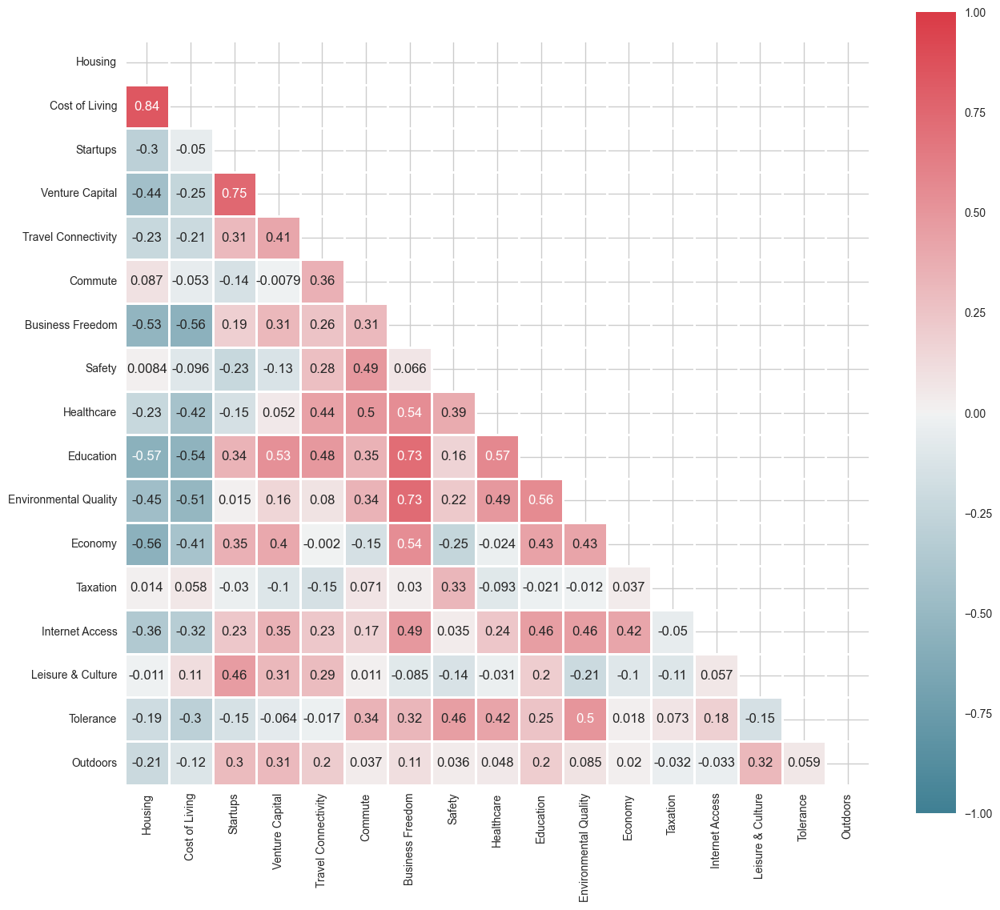

In [12]:
# I do a heatmap to see the correlation between the continuous variables. I use the method "spearman" since the variables are not following a normal distribution.

# Spearman's method

var = city_df[['Housing', 'Cost of Living', 'Startups', 'Venture Capital', 'Travel Connectivity',
                                      'Commute', 'Business Freedom','Safety', 'Healthcare', 'Education',
                                      'Environmental Quality', 'Economy',
                                      'Taxation', 'Internet Access', 'Leisure & Culture', 'Tolerance','Outdoors']]

numeric_df = city_df.select_dtypes(include=[float])
corr = var.corr(method='spearman')

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool)) 
 
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(15,13))
 
# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, s=75, l=50, center="light", as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, center=0, vmin=-1,  
            square=True, linewidths=1, cbar_kws={"shrink": 1}, annot = True)    

Analysis of the correlation: <br>

- Positive (0 a 1): A positive value close to 1 indicate a **strong positive correlation** (when one of them increase, the other one as well). <br>
- Negative (-1 a 0): A negative value close to 1 indicate a **strong negative correlation** (when one of them increase, the other one decrease). <br>
- Zero (0): Indicate that there's **no correlation** between variables.

### Continent comparison

In [13]:
numeric_columns = ['Safety', 'Economy', 'Cost of Living', 'Education', 'Business Freedom', 'Environmental Quality', 'Taxation']
city_df[numeric_columns] = city_df[numeric_columns].apply(pd.to_numeric, errors='coerce')

mean_values_by_continent = city_df.groupby('Continent')[numeric_columns].mean()

colors = {
    'Safety': '#FFCBA4',
    'Economy': '#ffe599',
    'Cost of Living': '#FF7518',
    'Education': '#CC5500',
    'Business Freedom': '#bf9000',
    'Environmental Quality': '#FFA500',
    'Taxation': '#FFA07A'
}

fig = go.Figure()

for col in numeric_columns:
    fig.add_trace(go.Bar(
        x=mean_values_by_continent.index,
        y=mean_values_by_continent[col],
        name=col,
        marker_color=colors[col]
    ))

fig.update_layout(
    title='Average Values of Safety, Economy, Cost of Living and Education by Continent',
    yaxis=dict(title='Average Value'),
    barmode='group',
    template='plotly_white',
    xaxis_showgrid=False,
    yaxis_showgrid=False
)

fig.show()

In [14]:
aqi_mean_by_continent = city_df.groupby('Continent')['AQI Value'].mean().reset_index()

aqi_category_by_continent = city_df.groupby(['Continent', 'AQI Category']).size().reset_index(name='Count')

color_1 = ['#FFA07A']

color_2 = {
    'Good': '#668f4f',
    'Moderate': '#b2cb91',
    'Unhealthy for Sensitive Groups': '#FFA500',
    'Hazardous': '#E34234',
    'Unhealthy': 'black',
}

fig_mean_aqi = px.bar(aqi_mean_by_continent,
                      x='Continent',
                      y='AQI Value', 
                      title='Valor Medio de AQI por Continente',
                      color_discrete_sequence=color_1)

fig_mean_aqi.update_layout(template='plotly_white',
    xaxis_showgrid=False,
    yaxis_showgrid=False
)

fig_mean_aqi.show()


fig_aqi_category = px.bar(aqi_category_by_continent,
                          x='Continent',
                          y='Count',
                          color='AQI Category', 
                          title='Distribución de Categorías de AQI por Continente', 
                          barmode='stack',
                          color_discrete_map=color_2)

fig_aqi_category.update_layout(template='plotly_white',
                               xaxis_showgrid=False,
                               yaxis_showgrid=False)

fig_aqi_category.show()


In [15]:
continent_avg = city_df.groupby('Continent')[['Startups', 'Business Freedom']].mean().reset_index()

continent_counts = city_df['Continent'].value_counts().reset_index()
continent_counts.columns = ['Continent', 'City Count']

continent_avg = continent_avg.merge(continent_counts, on='Continent')

fig = px.scatter(continent_avg, x='Startups', y='Business Freedom', size='City Count', color='Continent',
                 title='Relación entre Startups y Business Freedom por Continente',
                 labels={'Startups': 'Startups', 'Business Freedom': 'Business Freedom', 'Continent': 'Continent'},
                 hover_name='Continent', size_max=100)

fig.show()

# Guardo la figura en un archivo HTML
#fig.write_html("continent_startupsVSbusiness.html")

#### Maps per continent

In [16]:
for continent in city_df['Continent'].unique():
    continent_cities = city_df[city_df['Continent'] == continent]
    
    latitudes = continent_cities['lat'].tolist()
    longitudes = continent_cities['lng'].tolist()
    coordenadas = list(zip(latitudes, longitudes))
    
    latitud_inicial = latitudes[0]
    longitud_inicial = longitudes[0]
    
    mapa = folium.Map(location=[latitud_inicial, longitud_inicial], zoom_start=5)
    
    FastMarkerCluster(data=coordenadas).add_to(mapa)
    
    folium.Marker(location=[latitud_inicial, longitud_inicial]).add_to(mapa)
    

    display(mapa)

### Cities comparison

#### Cities per continent

In [17]:
# Number of cities per continent

cities_continent = city_df['Continent'].value_counts().sort_values(ascending=True)

fig = px.bar(cities_continent,
             x=cities_continent.values,
             y=cities_continent.index,
             text_auto = False,
             color_discrete_sequence=['#9bc27e'],
             labels={'x': 'Number of cities', 'y': 'Continent'}) 

fig.update_layout()

fig.update_layout(
    title ='Number of cities per continent under assessment',
    title_x =0.5, 
    yaxis_title = 'Continent',
    xaxis_title = 'Nº of cities',
    template = 'plotly_white',
    height=600,
    width=900,
    xaxis=dict(showgrid=False),
    yaxis=dict(showgrid=False)) 

fig.show()

# Guardo la figura en un archivo HTML
#fig.write_html("cities_per_continent.html")

In [18]:
fig = px.scatter_geo(city_df,
                     lat='lat',
                     lon='lng',
                     color='Continent',
                     hover_name='City',
                     size='Cost of Living',
                     projection='natural earth',
                     title='Distribution of cities under assessment',
                     height=600,
                     width=900, 
                     size_max=10,
                     hover_data={'lat': False, 'lng': False, 'Cost of Living': False, 'Continent': True, 'City': True})

fig.update_layout(
    geo=dict(
        showland=True,  
        landcolor='rgb(217, 217, 217)',  
        showocean=True,  
        oceancolor='rgb(204, 230, 255)'  
    )
)

fig.show()

# Guardo la figura en un archivo HTML
#fig.write_html("cities_worldmap.html")

In [19]:
from plotly.express import scatter_mapbox

scatter_mapbox(height=900,
               mapbox_style='open-street-map',
               data_frame=city_df,
               lat='lat',
               lon='lng',
               hover_name='City',
               hover_data=['Country'],
               zoom=1).show()

#### Environmental Quality and AQI Value

In [20]:
from plotly.express import scatter_mapbox

fig = px.scatter_mapbox(city_df,
                        lat='lat',
                        lon='lng',
                        hover_name='City',
                        hover_data=['Country'],
                        color='Environmental Quality',
                        size='Environmental Quality', 
                        size_max=12,  
                        zoom=1,
                        height=900,
                        mapbox_style='open-street-map')

fig.show()


In [22]:
heatmap = folium.Map(location = [city_df['lat'].mean(), city_df['lng'].mean()],zoom_start=2)

color_scale = LinearColormap(['green', 'yellow', 'red'],
                             caption='AQI Value')

HeatMap(data=city_df[['lat', 'lng', 'AQI Value']],
        gradient={0.2: 'green', 0.5: 'yellow', 1: 'red'},
        min_opacity=0.2).add_to(heatmap)

# Add the color scale legend
heatmap.add_child(color_scale)

heatmap

##### AQI: Air Quality Index

 The Air Quality Index (AQI) it tells how clean or polluted the air is. The AQI focuses on health effects you may experience within a few hours or days after breathing polluted air. The higher the AQI value, the greater the level of air pollution and the greater the health concern. 

 AQI Values:

- `0-50` Good
- `51-100` Moderate
- `101-200` Unhealthy for sensitive groups
- `201-300` Unhealthy
- `301-400` Very Unhealthy
- `401-500` Hazardous

In [24]:
city_world_AQI.head()

,Country,City,AQI Value,AQI Category,lat,lng
0,Russian Federation,Praskoveya,51,Moderate,44.7444,44.2031
1,Brazil,Presidente Dutra,41,Good,-5.2900,-44.4900
2,Italy,Priolo Gargallo,66,Moderate,37.1667,15.1833
3,Poland,Przasnysz,34,Good,53.0167,20.8833
4,United States of America,Punta Gorda,54,Moderate,16.1005,-88.8074


In [27]:
center_map = [0, 0] 

map = folium.Map(location=center_map, zoom_start=2.4)

def color_producer(aqi):
    if aqi <= 50:           # Good
        return 'green'        
    elif 50 < aqi <= 100:   # Moderate
        return 'lightgreen'   
    elif 101 <= aqi <= 150: # Unhealthy for Sensitive Groups 
        return 'yellow'       
    elif 151 <= aqi <= 200: # Unhealthy
        return 'orange'       
    elif 201 <= aqi <= 300: # Very unhealthy
        return 'red'          
    elif 301 <= aqi <= 500: # Hazardous
        return 'darkred'      
    else:
        return 'black'      # Beyond index or unknown


for _, row in city_world_AQI.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['lng']],
        radius=2,
        popup=f"{row['City']}<br>AQI Value: {row['AQI Value']}",
        color=color_producer(row['AQI Value']),
        fill=True,
        fill_opacity=0.7, 
        height=300
    ).add_to(map)

map

In [28]:
# Guardo la figura en un archivo HTML
#map.save("AQI_worldmap.html")

In [29]:
categories = ['Good', 'Moderate', 'Unhealthy for Sensitive Groups', 'Unhealthy', 'Very Unhealthy', 'Hazardous']
category_counts = city_world_AQI['AQI Category'].value_counts().sort_values(ascending=True)

colors = {
    'Good': 'green',
    'Moderate': 'lightgreen',
    'Unhealthy for Sensitive Groups': 'yellow',
    'Unhealthy': 'orange',
    'Very Unhealthy': 'red',
    'Hazardous': 'black'
}

fig = px.bar(
    x=category_counts,
    y=category_counts.index,
    orientation='h', 
    color=category_counts.index,
    color_discrete_map=colors,  
    labels={'x': 'number of cities', 'y': '', 'color': 'AQI Category'},
    height=800,
    width=800)

fig.update_layout(
    xaxis_title='',
    yaxis_title='',
    xaxis_showgrid=False,
    yaxis_showgrid=False,
    template='plotly_white',
    xaxis_tickvals=[]
)

fig.show()

# Guardo la figura en un archivo HTML
#fig.write_html("AQI_category.html")

In [31]:
aqi_mean_by_country = city_world_AQI.groupby('Country')['AQI Value'].mean().reset_index()
aqi_mean_by_country = aqi_mean_by_country.sort_values(by='AQI Value', ascending=False)

color_1 = ['#FFA07A']

fig_mean_aqi = px.bar(aqi_mean_by_country,
                      x='Country',
                      y='AQI Value', 
                      title='Average AQI per country',
                      color_discrete_sequence=color_1)

fig_mean_aqi.update_layout(template='plotly_white',
    xaxis_showgrid=False,
    yaxis_showgrid=False
)

fig_mean_aqi.show()

In [32]:
# AQI value per city
city_df_sorted_AQI = city_df.sort_values(by='AQI Value', ascending=False)

fig = px.bar(city_df_sorted_AQI,
             x='City',
             y='AQI Value',
             color='Country',
             title='AQI Value per city',
             labels={'AQI Value': 'AQI Value', 'City': 'City'},
             height=400, 
             width=800) 

fig.update_layout(xaxis_showgrid=False,
                  yaxis_showgrid=False,
                  template='plotly_white')  
fig.show()


In [33]:
aqi_category_by_country = city_world_AQI.groupby(['Country', 'AQI Category']).size().reset_index(name='Count')
aqi_category_by_country = aqi_category_by_country.sort_values(by='Count', ascending=False)

color_2 = {
    'Good': 'green',
    'Moderate': 'lightgreen',
    'Unhealthy for Sensitive Groups': 'yellow',
    'Unhealthy': 'orange',
    'Very Unhealthy': 'red',
    'Hazardous': 'black'
}

fig_aqi_category = px.bar(aqi_category_by_country,
                          x='Country',
                          y='Count',
                          color='AQI Category', 
                          title='AQI categories distribution per country', 
                          barmode='stack',
                          color_discrete_map=color_2,
                          height= 500)

fig_aqi_category.update_layout(template='plotly_white',
                               xaxis_showgrid=False,
                               yaxis_showgrid=False)

fig_aqi_category.show()

#### Top 10: Safety, Education, Economy, Cost of living, Environmental quality, Leisure and culture, Connectivity and Healthcare

In [97]:
top_10_safest_cities = city_df.nlargest(10, 'Safety')

colors = ['#4e6f43','#668f4f','#7fa465','#9bc27e','#b2cb91', '#c5e384', '#b3e1a7', '#a7e58e', '#d9f08c', '#e6f2b2', '#bbf1b1']

fig = px.bar(top_10_safest_cities, 
             x='Safety', 
             y='City', 
             color='Country', 
             color_discrete_sequence=colors,
             orientation='h',
             title='Top 10 Safety',
             labels={'Safety': 'Safety Score', 'City': 'City'},
             height=400, 
             width=900)  

fig.update_layout(xaxis_title='',
                  yaxis_title='City',
                  yaxis_categoryorder='total ascending',
                  xaxis_showgrid=False,
                  yaxis_showgrid=False,
                  template='plotly_white',
                  xaxis_tickvals=[])  
fig.show()

# Guardo la figura en un archivo HTML
#fig.write_html("top10_safety.html")


In [98]:
top_10_education = city_df.nlargest(10, 'Education')

colors = ['#aec6cf', '#a3c1da', '#a1c4f2', '#9fdaf6', '#a4d8e5', '#92d6e9', '#99e2f2', '#b3e5f5', '#b1e4f7', '#c0f7ff']


fig = px.bar(top_10_education,
             x='Education',
             y='City', 
             color='Country', 
             color_discrete_sequence=colors,
             orientation='h',
             title='Top 10 Education',
             labels={'Education': 'Eduation Score', 'City': 'City'},
             height=400,
             width=900) 

fig.update_layout(xaxis_title='',
                  yaxis_title='City',
                  yaxis_categoryorder='total ascending',
                  xaxis_showgrid=False,
                  yaxis_showgrid=False,
                  template='plotly_white',
                  xaxis_tickvals=[]
                  )  
fig.show()

# Guardo la figura en un archivo HTML
#fig.write_html("top10_education.html")

In [99]:
top_10_economy = city_df.nlargest(10, 'Economy')

colors = ['#ff6961', '#ffb3b3', '#ffbdbd', '#ff9aa2', '#ffacb7', '#ffafb0', '#ffada5', '#ffcccb', '#ffb7c5', '#ffccd5']

fig = px.bar(top_10_economy,
             x='Economy',
             y='City',
             color='Country',
             color_discrete_sequence=colors,
             orientation='h',
             title='Top 10 Economy',
             labels={'Economy': 'Economy Score', 'City': 'City'},
             height=400,
             width=900) 

fig.update_layout(xaxis_title='',
                  yaxis_title='City',
                  yaxis_categoryorder='total ascending',
                  xaxis_showgrid=False,
                  yaxis_showgrid=False,
                  template='plotly_white',
                  xaxis_tickvals=[]
                  )  
fig.show()

# Guardo la figura en un archivo HTML
#fig.write_html("top10_economy.html")

In [100]:
top_10_costliving = city_df.nlargest(10, 'Cost of Living')

colors = ['#cba3d8', '#dab4de', '#e1c3e8', '#e0bfe9', '#e6c9f2', '#d9a7e3', '#ddc1ef', '#e6c2f7', '#e3a8ff', '#ddb5e7']


fig = px.bar(top_10_costliving,
             x='Cost of Living',
             y='City',
             color='Country',
             color_discrete_sequence=colors,
             orientation='h',
             title='Top 10 Cost of Living',
             labels={'Cost of Living': 'Cost of Living Score', 'City': 'City'},
             height=400,
             width=900) 

fig.update_layout(xaxis_title='',
                  yaxis_title='City',
                  yaxis_categoryorder='total ascending',
                  xaxis_showgrid=False,
                  yaxis_showgrid=False,
                  template='plotly_white',
                  xaxis_tickvals=[]
                  )  
fig.show()

# Guardo la figura en un archivo HTML
#fig.write_html("top10_cost_living.html")

The higher score, the most desirable city to live (the cheapest)

In [105]:
top_10_environment = city_df.nlargest(10, 'Environmental Quality')

colors = ['#ffb347', '#ffd1b2', '#ffd1a3', '#ffb994', '#ffcc99', '#ffdab3', '#ffddb1', '#ffd9c2', '#ffe0a1', '#ffd2b2']


fig = px.bar(top_10_environment,
             x='Environmental Quality',
             y='City', 
             color='Country',
             color_discrete_sequence=colors,
             orientation='h',
             title='Top 10 Environmental Quality',
             labels={'Environmental Quality': 'Environmental Quality Score', 'City': 'City'},
             height=400,
             width=900) 

fig.update_layout(xaxis_title='',
                  yaxis_title='City',
                  yaxis_categoryorder='total ascending',
                  xaxis_showgrid=False,
                  yaxis_showgrid=False,
                  template='plotly_white',
                  xaxis_tickvals=[]
                  )  
fig.show()

# Guardo la figura en un archivo HTML
#fig.write_html("top10_environment.html")

In [102]:
top_10_leisure = city_df.nlargest(10, 'Leisure & Culture')

colors = ['#ffb3ba', '#ffccd5', '#ffc9de', '#ff9aa2', '#ffacb7', '#ffb6c1', '#ffd1d9', '#ffc9cb', '#ffb0c7', '#ffc0cb']

fig = px.bar(top_10_leisure,
             x='Leisure & Culture',
             y='City',
             color='Country',
             color_discrete_sequence=colors,
             orientation='h',
             title='Top 10 of Leisure & Culture',
             labels={'Leisure & Culture': 'Leisure & Culture Score', 'City': 'City'},
             height=400,
             width=900) 

fig.update_layout(xaxis_title='',
                  yaxis_title='City',
                  yaxis_categoryorder='total ascending',
                  xaxis_showgrid=False,
                  yaxis_showgrid=False,
                  template='plotly_white',
                  xaxis_tickvals=[]
                  )  
fig.show()

# Guardo la figura en un archivo HTML
#fig.write_html("top10_leisure.html")

In [103]:
top_10_connectivity = city_df.nlargest(10, 'Travel Connectivity')

colors = ['#77ddcc', '#a0e6d9', '#adeeee', '#b2f4e8', '#99ffcc', '#a3f7e8', '#b1e5e9', '#c8ffff', '#bbf6f6', '#ace7e7']

fig = px.bar(top_10_connectivity,
             x='Travel Connectivity',
             y='City',
             color='Country',
             color_discrete_sequence=colors,
             orientation='h',
             title='Top 10 of Travel Connectivity',
             labels={'Travel Connectivity': 'Travel Connectivity Score', 'City': 'City'},
             height=400,
             width=900) 

fig.update_layout(xaxis_title='',
                  yaxis_title='City',
                  yaxis_categoryorder='total ascending',
                  xaxis_showgrid=False,
                  yaxis_showgrid=False,
                  template='plotly_white',
                  xaxis_tickvals=[]
                  )  
fig.show()

# Guardo la figura en un archivo HTML
#fig.write_html("top10_connectivity.html")

In [104]:
top_10_connectivity = city_df.nlargest(10, 'Healthcare')

colors = '#bf9000','#ffe599','#ffd966', '#FFD580'

fig = px.bar(top_10_connectivity,
             x='Healthcare',
             y='City',
             color='Country',
             color_discrete_sequence=colors,
             orientation='h',
             title='Top 10 of Healthcare',
             labels={'Healthcare': 'Healthcare Score', 'City': 'City'},
             height=400,
             width=900) 

fig.update_layout(xaxis_title='',
                  yaxis_title='City',
                  yaxis_categoryorder='total ascending',
                  xaxis_showgrid=False,
                  yaxis_showgrid=False,
                  template='plotly_white',
                  xaxis_tickvals=[]
                  )  
fig.show()

# Guardo la figura en un archivo HTML
#fig.write_html("top10_healthcare.html")

#### Analysis of quality of life

In [42]:
# I create a new column of "Quality of Life"
city_df['Quality of Life'] = city_df[['Cost of Living', 'Travel Connectivity',
                                      'Commute', 'Business Freedom','Safety', 'Healthcare', 'Education',
                                      'Environmental Quality', 'Economy',
                                      'Leisure & Culture', 'Tolerance']].median(axis=1)

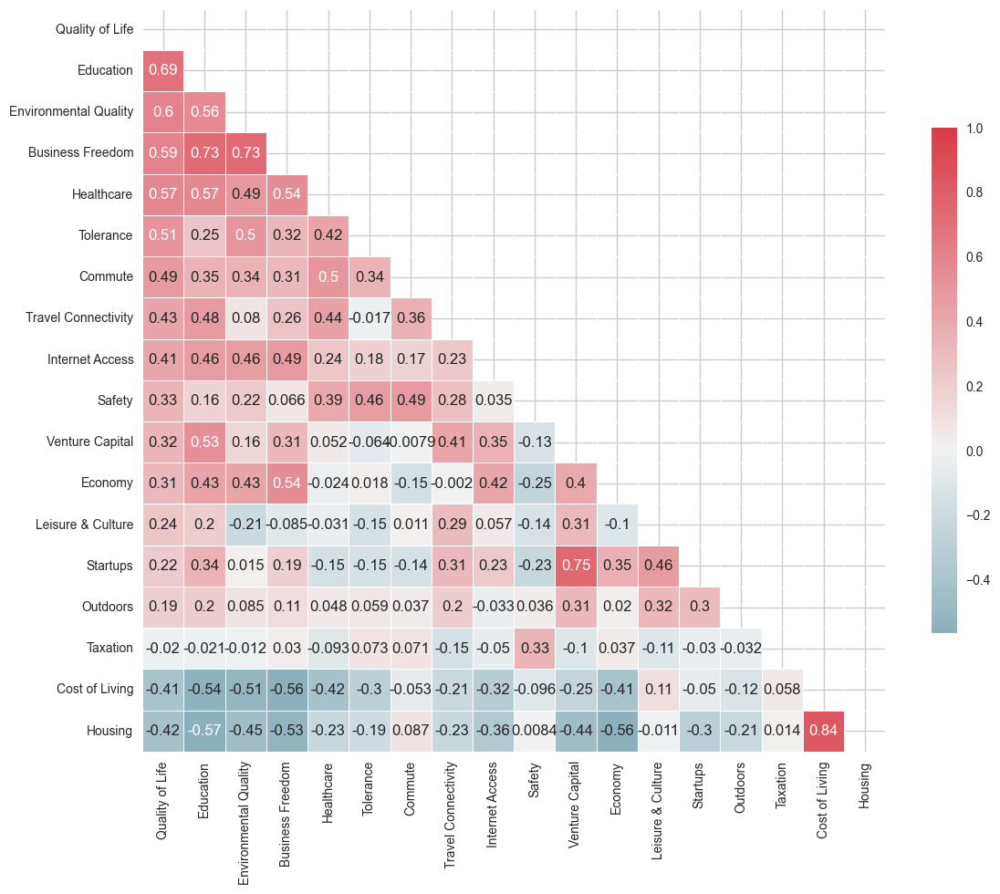

In [43]:
# I do a heatmap to see the correlation between the continuous variables. I use the method "spearman" since the variables are not following a normal distribution.
var = city_df[['Housing', 'Cost of Living', 'Startups', 'Venture Capital', 'Travel Connectivity',
                                      'Commute', 'Business Freedom','Safety', 'Healthcare', 'Education',
                                      'Environmental Quality', 'Economy',
                                      'Taxation', 'Internet Access', 'Leisure & Culture', 'Tolerance','Outdoors', 'Quality of Life']]

corr = var.corr(method='spearman').sort_values(by='Quality of Life', axis=0, ascending=False).sort_values(by='Quality of Life', axis=1, ascending=False)
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(12, 12))
cmap = sns.diverging_palette(220, 10, as_cmap=True)

sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True) 
plt.tight_layout()

In [44]:
city_df_sorted_quality = city_df.sort_values(by='Quality of Life', ascending=False)

fig_quality_of_life = px.bar(city_df_sorted_quality, x='City', y='Quality of Life', title='Quality of Life per City', height=400, width=2000)
fig_quality_of_life.update_xaxes(tickfont=dict(size=9))
fig_quality_of_life.show()

In [45]:
# Healthcare per city 
city_df_sorted_healthcare = city_df.sort_values(by='Healthcare', ascending=False)
fig_healthcare_city = px.bar(city_df_sorted_healthcare, x='City', y='Healthcare', title='Healthcare per city')
fig.update_xaxes(tickfont=dict(size=10))
fig_healthcare_city.show()

In [46]:
center_map = [0, 0] 

map = folium.Map(location=center_map, zoom_start=2)

def color_producer(qol):
    if qol > 7:
        return 'green'
    elif 5 <= qol <= 7:
        return 'orange'
    else:
        return 'red'

for _, row in city_df.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['lng']],
        radius=5,
        popup=f"{row['City']}<br>Quality of Life: {row['Quality of Life']}",
        color=color_producer(row['Quality of Life']),
        fill=True,
        fill_opacity=0.7
    ).add_to(map)

legend_html = '''
     <div style="position: fixed; 
     bottom: 50px; left: 50px; width: 150px; height: 120px; 
     background-color: white; border:2px solid grey; z-index:9999; font-size:14px;
     ">&nbsp; Quality of Life Legend <br>
     &nbsp; <i class="fa fa-circle" style="color:green"></i>&nbsp; > 7 <br>
     &nbsp; <i class="fa fa-circle" style="color:orange"></i>&nbsp; 5 - 7 <br>
     &nbsp; <i class="fa fa-circle" style="color:red"></i>&nbsp; < 5
     </div>
     '''

map.get_root().html.add_child(folium.Element(legend_html))

map

#### Analysis of transport and connectivity

In [48]:
# I create a new column of "Transport and Travel Connectivity"
city_df['Transport and Travel Connectivity'] = city_df[['Travel Connectivity','Commute']].mean(axis=1)

In [49]:
# Connectivity per city 
city_df_sorted_connectivity = city_df.sort_values(by='Transport and Travel Connectivity', ascending=False)
fig_connectivity_city = px.bar(city_df_sorted_connectivity, x='City', y='Transport and Travel Connectivity', title='Transport and Travel Connectivity per city')
fig.update_xaxes(tickfont=dict(size=10))
fig_connectivity_city.show()

In [50]:
continent_avg = city_df.groupby('Continent')[['Travel Connectivity', 'Economy']].mean().reset_index()

continent_counts = city_df['Continent'].value_counts().reset_index()
continent_counts.columns = ['Continent', 'City Count']

continent_avg = continent_avg.merge(continent_counts, on='Continent')

fig = px.scatter(continent_avg, x='Travel Connectivity', y='Economy', size='City Count', color='Continent',
                 title='Relation between Travel Connectivity and Economy per Continent',
                 labels={'Travel Connectivity': 'Travel Connectivity', 'Economy': 'Economy', 'Continent': 'Continent'},
                 hover_name='Continent', size_max=100)

fig.show()

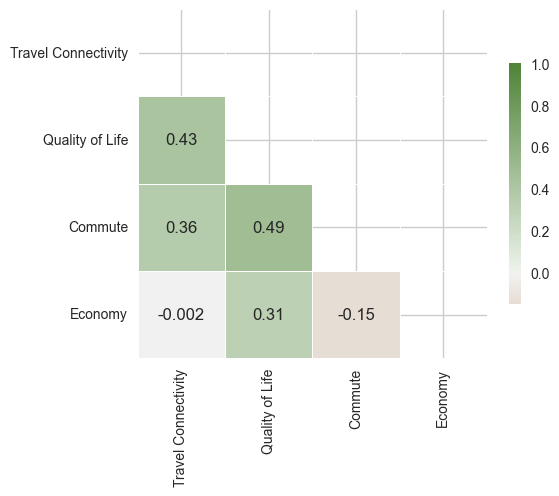

In [51]:
# Correlation between Travel Connectivity, Commute, Economy, and Quality of life
var = city_df[['Travel Connectivity','Commute','Economy','Quality of Life']]

corr = var.corr(method='spearman').sort_values(by='Travel Connectivity', axis=0, ascending=False).sort_values(by='Travel Connectivity', axis=1, ascending=False)

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

f, ax = plt.subplots(figsize=(6, 6))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(45, 120, center="light", as_cmap=True)

sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True) 

plt.tight_layout()

##### A/B Testing

I will use the test of Shapiro-Wilk to compare if the variables follow a normal distribution (gaussian) or not.

- $H_{0}$: the sample follow a normal distribution. 
- $H_{1}$: the samples DOESN`T follow a normal distribution. 

In [52]:
travel_connectivity = city_df['Travel Connectivity']
economy = city_df['Economy']
stat, p = shapiro(travel_connectivity)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('No podemos rechazar que siga una distribución Gaussiana')
else:
	print('No sigue una distribución Gaussiana')

stat=0.926, p=0.000
No sigue una distribución Gaussiana


In [53]:
stat, p = shapiro(economy)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('No podemos rechazar que siga una distribución Gaussiana')
else:
	print('No sigue una distribución Gaussiana')

stat=0.942, p=0.000
No sigue una distribución Gaussiana


Since the variables don't follow a normal distribution, i will use the "non parametric tests".
In this case, to evaluate the relation between "Business Freedom" and "Startup", I will use Spearman.

*   $H_{0}$: las muestras son independientes. 
*   $H_{1}$: existe una dependencia entre las muestras. 

In [54]:
stat, p = spearmanr(travel_connectivity, economy)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('Probablemente independientes')
else:
	print('Probablemente dependientes')

stat=-0.002, p=0.974
Probablemente independientes


Since they dont follow a normal distribution, I will use Mann-Whitney:

*   $H_{0}$: Hay diferencia significativa entre las medias de ambas variables.
*   $H_{1}$: No existe una diferencia significativa entre las medias de las variables.

In [55]:
mannwhitney_test = mannwhitneyu(travel_connectivity, economy, alternative='two-sided')
print('Mann-Whitney U Test:')
print('Estadístico U:', mannwhitney_test.statistic)
print('p-valor:', mannwhitney_test.pvalue)

Mann-Whitney U Test:
Estadístico U: 18077.0
p-valor: 3.9356178647865714e-22


$Conclusión$

Rechazo de la Hipótesis Nula: Dado el p-valor extremadamente bajo, se rechaza la hipótesis nula de que hay diferencia significativa entre las medias de "Business Freedom" y "Startup"", comprobando que no hay diferencia significativa en las medias de los dos grupos.

#### Analysis of Startups and Business Freedom

In [56]:
# Startups per city 
city_df_sorted_startups = city_df.sort_values(by='Startups', ascending=False)

fig = px.bar(
    city_df_sorted_startups,
    x='City',
    y='Startups',
    color='Country',
    title='Startups per city',
    labels={'Startups': 'Startups', 'City': 'City'},
    height=400, 
    width=800)

fig.update_layout(
    xaxis_title='',
    yaxis_title='',
    xaxis_showgrid=False,
    yaxis_showgrid=False,
    template='plotly_white')

fig.show()

In [57]:
# Relation between Business Freedom and Economy
fig_business_economy = px.scatter(city_df, x='Business Freedom', y='Economy', 
                                  color='City', 
                                  size='Economy', 
                                  hover_name='City',
                                  title='Business Freedom Vs Economy')
fig_business_economy.show()

I will check if there's a significant correlation between both variables: Business Freedom and Startup

**Tests de Normalidad**

I will use the test of Shapiro-Wilk to compare if the variables follow a normal distribution (gaussian) or not.

- $H_{0}$: the sample follow a normal distribution. 
- $H_{1}$: the samples DON`T follow a normal distribution. 

In [58]:
business_freedom = city_df['Business Freedom']
stat, p = shapiro(business_freedom)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('No podemos rechazar que siga una distribución Gaussiana')
else:
	print('No sigue una distribución Gaussiana')

stat=0.855, p=0.000
No sigue una distribución Gaussiana


In [59]:
startup = city_df['Startups']
stat, p = shapiro(startup)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('No podemos rechazar que siga una distribución Gaussiana')
else:
	print('No sigue una distribución Gaussiana')

stat=0.958, p=0.000
No sigue una distribución Gaussiana


I double check it using the test K2 de D'Agostino:

In [60]:
from scipy.stats import normaltest

stat, p = normaltest(business_freedom)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('No podemos rechazar que siga una distribución Gaussiana')
else:
	print('No sigue una distribución Gaussiana')

stat=42.550, p=0.000
No sigue una distribución Gaussiana


In [61]:
stat, p = normaltest(startup)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('No podemos rechazar que siga una distribución Gaussiana')
else:
	print('No sigue una distribución Gaussiana')

stat=17.570, p=0.000
No sigue una distribución Gaussiana


**Tests de Correlación**

Since the variables don't follow a normal distribution, i will use the "non parametric tests".
In this case, to evaluate the relation between "Business Freedom" and "Startup", I will use Spearman.

*   $H_{0}$: las muestras son independientes. 
*   $H_{1}$: existe una dependencia entre las muestras. 

In [62]:
stat, p = spearmanr(business_freedom, startup)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('Probablemente independientes')
else:
	print('Probablemente dependientes')

stat=0.188, p=0.002
Probablemente dependientes


Conclusion: Both variables "Business freedom" and "Startups" are dependants which means that the number of startups in a city depends on the business freedom.

#### A/B testing for Business freedom

In [63]:
mean_business_freedom = city_df.groupby('Continent')['Business Freedom'].mean().reset_index()
mean_business_freedom = mean_business_freedom.sort_values(by='Business Freedom', ascending=False)

fig_business_continent = px.bar(mean_business_freedom,
                                x='Continent',
                                y='Business Freedom', 
                                title='Business Freedom per Continent',
                                template='plotly_white',
                                color_discrete_sequence=['#9bc27e'])

fig_business_continent.update_layout(
    xaxis=dict(showgrid=False),  
    yaxis=dict(showgrid=False))

fig_business_continent.show()

* $H_{0}$: There is NO significant difference between the mean values of Europe and North America regarding Business Freedom.
* $H_{1}$: There is significant difference between the means of the variables.

In [64]:
Europa_grupo_1 = city_df[city_df['Continent'] == 'Europe']['Business Freedom']
NA_grupo_2 = city_df[city_df['Continent'] == 'North America']['Business Freedom']

In [65]:
def analisis_preliminar(grupo1, grupo2, alpha=0.05):
    # Prueba de Shapiro-Wilk para normalidad
    stat, p_norm1 = stats.shapiro(grupo1)
    stat, p_norm2 = stats.shapiro(grupo2)
    print(f"Normalidad Grupo 1: p-value = {p_norm1}")
    print(f"Normalidad Grupo 2: p-value = {p_norm2}")
    
    # Prueba de Levene para igualdad de varianzas
    stat, p_levene = stats.levene(grupo1, grupo2)
    print(f"Test of Levene (igualdad de varianzas): p-value = {p_levene}")
    
    # Elegir prueba estadística
    if p_norm1 > alpha and p_norm2 > alpha and p_levene > alpha:
        # Asumimos varianzas iguales, distribuciones normales
        t_stat, p_ttest = stats.ttest_ind(grupo1, grupo2)
        print(f"Test t de Student: t-statistic = {t_stat}, p-value = {p_ttest}")
    else:
        # Usar Mann-Whitney si no es normal o varianzas diferentes
        u_stat, p_utest = stats.mannwhitneyu(grupo1, grupo2)
        print(f"Test of Mann-Whitney: U-statistic = {u_stat}, p-value = {p_utest}")

In [66]:
analisis_preliminar(Europa_grupo_1, NA_grupo_2)

Normalidad Grupo 1: p-value = 2.1007122708027737e-09
Normalidad Grupo 2: p-value = 1.995171052570356e-17
Test of Levene (igualdad de varianzas): p-value = 1.268850043158975e-12
Test of Mann-Whitney: U-statistic = 3647.0, p-value = 0.1216781078730243


*Conclusion:*

- With Shapiro-Willk test I verified that both groups donts follow a normal distribution (the p-value is <0.05).
- With Levene's test I verified that both groups dont have equal variances.
- With Mann-Whitney (non-parametric test) I can accept the hiphotesis since the p-value is >0.05: There is NO significant difference between the averages of Europe and North America regarding Business Freedom.

calcular la ciudad mas cercana dentro de mi dataset para estas coordenadas

## K-Nearest Neighbours (KNN)

In [120]:
# Defino las variables

variables = ['Cost of Living', 'Travel Connectivity', 'Safety', 'Healthcare', 'Education', 'Environmental Quality', 'Economy', 'Leisure & Culture']
selected_variables = input("Seleccione tres variables separadas por comas: ").split(',')

# Elimino espacios en blanco adicionales
selected_variables = [var.strip() for var in selected_variables]

if len(selected_variables) != 3:
    print('Please select exactly three variables.')
else:
    # variables seleccionadas
    print(f"You selected: {', '.join(selected_variables)}")

You selected: Safety, Education, Economy


In [121]:
# Normalizo los datos seleccionados
scaler = StandardScaler()
normalized_data = scaler.fit_transform(city_df[selected_variables])
normalized_df = pd.DataFrame(normalized_data, columns=selected_variables)
normalized_df['City'] = city_df['City']

In [122]:
# Entreno el modelo KNN
knn = NearestNeighbors(n_neighbors=5)
knn.fit(normalized_df[selected_variables])

NearestNeighbors()

In [123]:
# ingresar valores para las variables seleccionadas
user_input = []
for var in selected_variables:
    value = float(input(f'Enter value for {var}: '))
    user_input.append(value)

In [124]:
# Normalizo la entrada del usuario
user_input = scaler.transform([user_input])[0]

In [125]:
# vecinos más cercanos
distances, indices = knn.kneighbors([user_input])

In [126]:
print("The most similar cities based on your input are:")
for idx in indices[0]:
    print(normalized_df.iloc[idx]['City'])

The most similar cities based on your input are:
Singapore
Hong Kong
Zurich
Boston
Galway
